# Podstawowe predykaty geometryczne, przeprowadzanie testów, wizualizacja i opracowanie wyników

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from bitalg.tests.test1 import Test
from bitalg.visualizer.main import Visualizer

# Przydatne funkcje 

In [2]:
def draw_points(points, point_size, title = None):
    vis = Visualizer()
    if title: vis.add_title(title)
    vis.add_point(points, s=point_size, color='green')
    vis.axis_equal()
    vis.show()
    return vis

In [3]:
def draw_line(points_left, points_mid, points_right, point_size, title = None):
    vis = Visualizer()
    if title: vis.add_title(title)
    vis.add_line(((-1.0, 0.0), (1.0,0.1)), color='red')
    vis.add_point(points_left, s=point_size, color=['green'])
    vis.add_point(points_mid, s=point_size, color=['purple'])
    vis.add_point(points_right, s=point_size, color=['orange'])
    vis.axis_equal()
    vis.show()
    return vis

In [4]:
def draw_example():
    vis = Visualizer()
    vis.add_line(((0, 2), (10, 7)))
    vis.add_point((4, 4), s=30, color='green')
    vis.add_point((6, 6), s=30, color='red')
    vis.add_point((7, 4), s=30, color='purple')
    vis.show()

### Wprowadzenie
Celem ćwiczenia jest określenie po której stronie prostej znajduje się punkt.

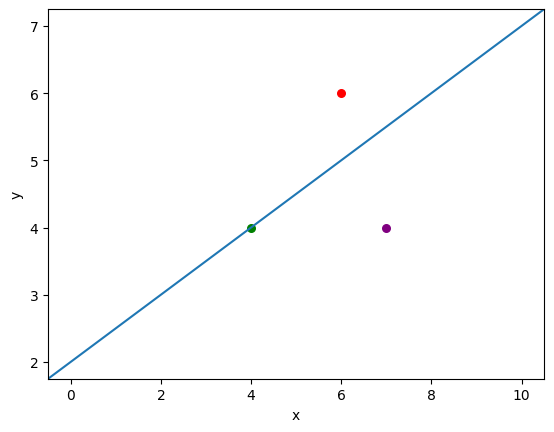

In [5]:
draw_example()

Do tego celu potrzebujesz wygenerować zbiory punktów testowych.


# Generowanie losowych punktów na płaszczyźnie

Uzupełnij funkcję ```generate_uniform_points```
 (Aby generować losowo liczby rzeczywiste bardzo przydatna może okazać się jakaś funkcja biblioteczna)

In [6]:
def generate_uniform_points(left, right, n = 10 ** 5):
    """
    Funkcja generuje równomiernie n punktów na kwadratowym obszarze od left do right (jednakowo na osi y) o współrzędnych rzeczywistych
    :param left: lewy kraniec przedziału
    :param right: prawy kraniec przedziału
    :param n: ilość generowanych punktów
    :return: tablica punktów w postaci krotek współrzędnych np. [(x1, y1), (x2, y2), ... (xn, yn)]
    """

    
    return np.random.uniform(low = left, high = right, size = (n, 2))

<span style="color:red">Ćw.</span> Wygeneruj $10^5$ losowych punktów w przestrzeni 2D o współrzędnych z przedziału $x, y \in \left[-1000,1000\right]^{2}$.

In [7]:
points_a = generate_uniform_points(-1000, 1000, 10 ** 5)

Zwizualizuj wygenerowane punkty

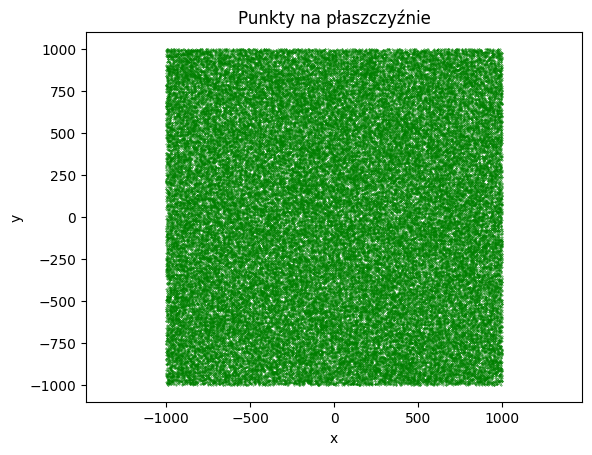

In [8]:
draw_points(points_a, 0.1, 'Punkty na płaszczyźnie')#.save('points_small')

<span style="color:red">Ćw.</span> Wygeneruj $10^5$ losowych punktów w przestrzeni 2D o współrzędnych z przedziału $ x, y \in \left[-10^{14},10^{14}\right]^{2}$. Uzupełnij funkcję ```generate_big_num_of_points_2D```. Sprawdź, czy różni się wizualizalnie wynik tego ćwiczenia z poprzednim.

In [9]:
points_b = generate_uniform_points(-10 ** 14, 10 ** 14, 10 ** 5)

Zwizualizuj wygenerowane punkty.

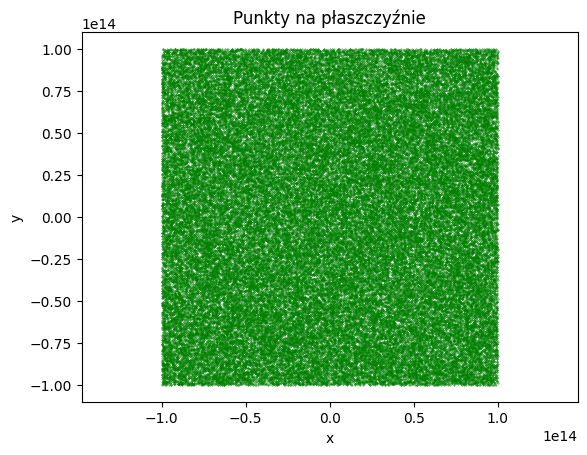

In [10]:
draw_points(points_b, 0.1, 'Punkty na płaszczyźnie')#.save('points_large')

Uzupełnij funkcję ```generate_circle_points```

Zastanów się w jaki sposób generować punkty jednostajnie na okręgu.

In [11]:
def generate_circle_points(O, R, n = 100):
    """
    Funkcja generuje jednostajnie n punktów na okręgu o środku O i promieniu R
    :param O: krotka współrzędnych x, y określająca środek okręgu
    :param R: promień okręgu 
    :param n: ilość generowanych punktów
    :return: tablica punktów w postaci krotek współrzędnych
    """

    def map_theta_to_points(theta, O, R):
        #funkcja pomocnicza, mapuje współrzędne biegunowe na współrzędne kartezjańskie
        return (O[0] + R * np.cos(theta), O[1] + R * np.sin(theta))
    
    theta_array = np.random.uniform(low = 0, high = 2 * np.pi, size = n)
    return np.array([map_theta_to_points(theta, O, R) for theta in theta_array])

<span style="color:red">Ćw.</span> Wygeneruj $ 1000$ losowych punktów w przestrzeni 2D leżących na okręgu o środku $ O = (0,0)$ i promieniu $ R = 100$. 

Uzupełnij funkcję ```generate_points_on_circle_2D```.

In [12]:
points_c = generate_circle_points((0, 0), 100)

Zwizualizuj wygenerowane punkty.

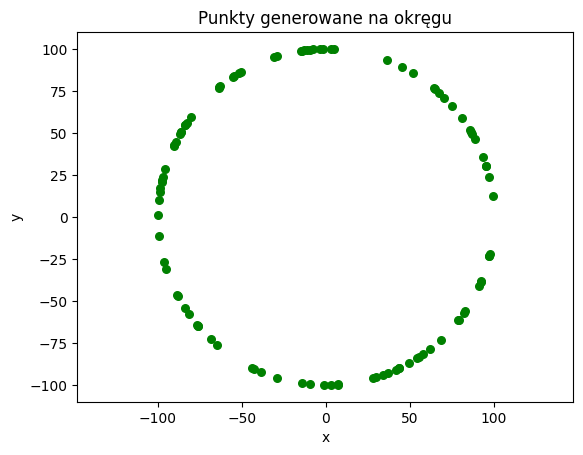

In [13]:
draw_points(points_c, 30, 'Punkty generowane na okręgu')#.save('circle')

Uzupełnij funkcję ```generate_collinear_points```.

In [14]:
def generate_collinear_points(a, b, n=100):
    """
    Funkcja generuje równomiernie n współliniowych punktów leżących na odcinku ab pomiędzy punktami a i b
    :param a: krotka współrzędnych oznaczająca początek odcinka
    :param b: krotka współrzędnych oznaczająca koniec odcinka
    :param n: ilość generowanych punktów
    :return: tablica punktów w postaci krotek współrzędnych
    """

    unit_direction_vector = np.array([b[0]-a[0], b[1]-a[1]])
    unit_direction_vector /= np.linalg.norm(unit_direction_vector)
    
    direction_vector_arr = np.random.uniform(low = -1000, high = 1000, size = (n, 1))

    return direction_vector_arr * unit_direction_vector + np.array([a[0], a[1]])

<span style="color:red">Ćw.</span>  Wygeneruj $ 1000$ losowych punktów w przestrzeni 2D o współrzędnej z przedziału $ x \in \langle -1000,1000 \rangle$ leżących na prostej wyznaczonej przez wektor $ \overrightarrow{ab}$. Przyjmij punkty $ a = (-1.0, 0.0)$ oraz $ b = (1.0, 0.1)$. Uzupełnij funkcję ```generate_points_on_line_2D```.

In [15]:
points_d = generate_collinear_points((-1.0, 0.0), (1.0,0.1))

Zwizualizuj wygenerowane punkty.

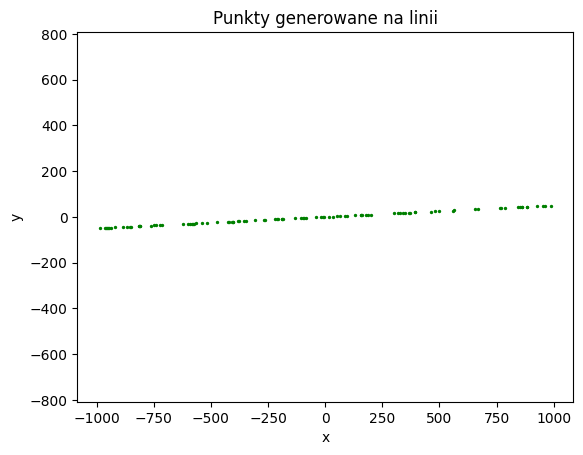

In [16]:
draw_points(points_d, 2, 'Punkty generowane na linii')#.save('line')

Przeprowadź test poprawności powyższych funkcji

In [17]:
Test().runtest(1, generate_uniform_points, generate_circle_points, generate_collinear_points)

Lab 1, task 1:
	Test 1: Passed
	Test 2: Passed
	Test 3: Passed
	Test 4: Passed
Result: 4/4
Time: 0.130s


# Po której stornie prostej znajduje się punkt?

Prostym sposobem do obliczenia, po której stronie prostej znajduje się punkt jest obliczenie iloczynu wektorowego 
$\overrightarrow{ab} \times \overrightarrow{ac}$, gdzie $ c = (x,y)$ jest punktem, dla którego poszukujemy wiadomości o lokalizacji względem prostej przechodzącej przez punkty $ a$ i $ b$. Metoda ta jest równoznaczna z obliczeniem wyznacznika macierzy $ 2\times2$:  

$$
(1)\det(a, b, c)= \begin{vmatrix}
       a_{x} - c_{x} & a_{y} - c_{y} \\
       b_{x} - c_{x} & b_{y} - c_{y} 
              \end{vmatrix}
$$


lub wyznacznika macierzy $ 3\times3$:

$$
(2)\det(a, b, c)= \begin{vmatrix}
       a_{x} & a_{y} & 1 \\
       b_{x} & b_{y} & 1 \\
       c_{x} & c_{y} & 1
              \end{vmatrix}
$$

Upraszczając tą macierz przez odjęcie drugiego wiersza od trzeciego i odjęcie pierwszego wiersza od drugiego otrzymamy:

$$
\det(a, b, c)  = \begin{vmatrix}
              a_{x}         & a_{y}         & 1 \\
              b_{x} - a_{x} & b_{y} - a_{y} & 0 \\
              c_{x} - b_{x} & c_{y} - b_{y} & 0
                     \end{vmatrix}
              = (b_{x} - a_{x})(c_{y} - b_{y}) - (b_{y} - a_{y})(c_{x} - b_{x})
$$

Jest to wzór, z który opisuje pole równoległoboku mającego boki $ ab$ oraz $ ac$ (Dowód dlaczego tak jest, do zrobienia w domu)  
Dlaczego wiemy, że po obliczeniu wskaźnika podanego powyżej będziemy wiedzieć, po której stornie prostej znajduje się punkt?</font>
<font size="1">
</br>
***

**Dowód**:  

Załóżmy, że mamy dane trzy punkty w przestrzeni 2-wymiarowej $A, B$ oraz $C$. Znajdujemy prostą przechodzącą przez punkty $A$ i $B$. Następnie obliczamy $C_{y}$ przy danym $C_{x}$ i sprawdzamy czy punkt leży nad czy pod prostą.
Współczynnik nachylenia prostej jest nastepujący:

$$a = \frac{B_{y} - A_{y}}{B_{x} - A_{x}}
$$
Natomiast współczynnik $b$ wynosi:

$$b = B_{y} - \frac{(B_{y} - A_{y})B_{x}}{B_{x} - A_{x}}
$$

Po wpisaniu do równania $y = ax + b$ wyliczonego nachylenia prostej, współczynnika $b$ oraz zmiennej $C_{x}$ otrzymujemy:

$$y = \left(\frac{B_{y} - A_{y}}{B_{x} - A_{x}}\right)C_{x}+ \left(B_{y} - \frac{(B_{y} - A_{y})B_{x}}{B_{x} - A_{x}}\right)
$$

Otzymujemy punkt $C$ po lewej stronie prostej jeżeli $C_{y} - y > 0$, po prawej jeżeli $C_{y} - y < 0$, a punkt $C$ leżący na prostej, jeżeli $C_{y} - y = 0$. Przekształcimy powyższe równanie dla $C_{y} - y > 0$:

$$C_{y} - y > 0$$ 
$$C_{y} - \left(\frac{B_{y} - A_{y}}{B_{x} - A_{x}}\right)C_{x} - \left(B_{y} - \frac{(B_{y} - A_{y})B_{x}}{B_{x} - A_{x}}\right) > 0$$
$$C_{y}(B_{x} - A_{x}) - C_{x}(B_{y} - A_{y}) - B_{y}(B_{x} - A_{x}) + B_{x}(B_{y} - A_{y}) > 0$$
$$(C_{y} - B_{y})(B_{x} - A_{x}) + (B_{x} - C_{x})(B_{y} - A_{y}) > 0$$ 
$$(C_{y} - B_{y})(B_{x} - A_{x}) - (C_{x} - B_{x})(B_{y} - A_{y}) > 0$$

Zatem widzimy, że ostatnie równie jest takie same co przy równaniu wyznacznika macierzy $3\times3$. Niejawnie założyliśmy tutaj, że $B_{x}$ jest wieksze od $A_{x}$ , jeżeli byłoby odwrotnie zmieniłby się tylko znak nierówności na przeciwny. W naszym przypadku pokazaliśmy, że $C$ znajduje się po lewej stronie prostej jeżeli wyznacznik jest dodatni oraz po prawej stronie prostej, jeżeli wyznacznik jest ujemny. $Q.E.D$

---
Kolejnym zadaniem będzie zaimplementowanie własnych wyznaczników $(1)$ oraz $(2)$ i porówanie ich szybkości działania z wyznacznikami bibliotecznymi w testowaniu dla różnych zbiorów punktów. Co dodatkowo chcemy sprawdzić, czy wszystkie wyznaczniki podobnie kwalifikują podział względem danej lini.

Uzupełnij funkcje ```mat_det_3x3```

In [18]:
def mat_det_3x3(a, b, c):
    """
    Obliczanie wyznacznika macierzy 3x3 bez użycia funkcji bibliotecznych
    :param a: krotka współrzędnych (x, y) pierwszego punktu tworzącego naszą prostą
    :param b: krotka współrzędnych (x, y) drugiego punktu tworzącego naszą prostą
    :param c: krotka współrzędnych (x, y) punktu, którego położenie względem prostej chcemy znaleźć
    :return: wartość wyznacznika macierzy
    """
    a_x, a_y = a
    b_x, b_y = b
    c_x, c_y = c
    
    return a_x * b_y + a_y  * c_x + b_x * c_y - c_x * b_y - c_y * a_x - b_x * a_y

Uzupełnij funkcję ```mat_det_3x3_lib```, ale tym razem wykorzystaj dowolną funckję biblioteczną do obliczenia wyznacznika

In [19]:
def mat_det_3x3_lib(a, b, c):
    """
    Obliczanie wyznacznika macierzy 3x3 z użyciem funkcji bibliotecznych
    :param a: krotka współrzędnych (x, y) pierwszego punktu tworzącego naszą prostą
    :param b: krotka współrzędnych (x, y) drugiego punktu tworzącego naszą prostą
    :param c: krotka współrzędnych (x, y) punktu, którego położenie względem prostej chcemy znaleźć
    :return: wartość wyznacznika macierzy
    """
    matrix = np.array([[a[0], a[1], 1],
                       [b[0], b[1], 1],
                       [c[0], c[1], 1]])
    return np.linalg.det(matrix)

Uzupełnij funkcje ```mat_det_2x2```

In [20]:
def mat_det_2x2(a, b, c):
    """
    Obliczanie wyznacznika macierzy 2x2 bez użycia funkcji bibliotecznych
    :param a: krotka współrzędnych (x, y) pierwszego punktu tworzącego naszą prostą
    :param b: krotka współrzędnych (x, y) drugiego punktu tworzącego naszą prostą
    :param c: krotka współrzędnych (x, y) punktu, którego położenie względem prostej chcemy znaleźć
    :return: wartość wyznacznika macierzy
    """
    a_x, a_y = a
    b_x, b_y = b
    c_x, c_y = c

    a00, a01 = (a_x - c_x), (a_y - c_y)
    a10, a11 = (b_x - c_x), (b_y - c_y)
    return a00 * a11 - a01 * a10

Uzupełnij funkcję ```mat_det_2x2_lib```, ale tym razem wykorzystaj dowolną funckję biblioteczną do obliczenia wyznacznika

In [21]:
def mat_det_2x2_lib(a, b, c):
    """
    Obliczanie wyznacznika macierzy 2x2 z użyciem funkcji bibliotecznych
    :param a: krotka współrzędnych (x, y) pierwszego punktu tworzącego naszą prostą
    :param b: krotka współrzędnych (x, y) drugiego punktu tworzącego naszą prostą
    :param c: krotka współrzędnych (x, y) punktu, którego położenie względem prostej chcemy znaleźć
    :return: wartość wyznacznika macierzy
    """
    matrix = np.array([[a[0] - c[0], a[1] - c[1]],
                       [b[0] - c[0], b[1] - c[1]]])
    return np.linalg.det(matrix)

Przetestujmy napisane powyżej funkcje.

In [22]:
Test().runtest(2, mat_det_3x3, mat_det_2x2, mat_det_3x3_lib, mat_det_2x2_lib)

Lab 1, task 2:
	Test 1: Passed
	Test 2: Passed
Result: 2/2
Time: 0.000s


<span style="color:red">Ćw.</span> Klasyfikacja punktów względem prostej - zaimplementuj funkcję ```categorize_points```, która skwalifukuje punkty względem prostej wyznacznonej przez wektor $\large \overrightarrow{ab}$ (prosta przechodząca przez punkty $\large a$ oraz $\large b$.

In [23]:
def categorize_points(points, a, b, mat_det_func, eps):
    """
    :param points: tablica punktów w postaci krotek współrzednych
    :param a: krotka współrzędnych oznaczająca początek odcinka
    :param b: krotka współrzędnych oznaczająca koniec odcinka
    :param mat_det_func: funkcja która będzie tutaj używana do obliczenia wyznacznika macierzy
    :param eps: epsilon - jak blisko wyznacznik macierzy ma być blisko zera, aby uznać punkt za leżący na prostej
    :return: 3 tablice zawierające kolejno zbiory punktów: leżące na lewo od prostej, leżące na prostej, leżące na prawo od prostek
    """
    left = []
    right = []
    center = []

    for point in points:
        det = mat_det_func(a, b, point)
        if det < -eps: right.append(point)
        elif det > eps: left.append(point)
        else: center.append(point)
    
    return left, center, right

In [24]:
a = (-1.0, 0.0)
b = (1.0, 0.1)

## Klasyfikacja punktów
Rozkład punktów dla każdej konfiguracji jest zapisywany w tabeli points_distribution

In [25]:
eps_dict = {"0": 0, "14": 1e-14, "12": 1e-12, "10": 1e-10, "8": 1e-8}

mat_fun_dict = {"3x3": mat_det_3x3, "2x2": mat_det_2x2, "3x3_lib": mat_det_3x3_lib, "2x2_lib": mat_det_2x2_lib}

points_dict = {"plane_small": points_a, "plane_large": points_b, "circle": points_c, "line": points_d}

plot_points_size = {"plane_small":0.1, "plane_large": 0.1, "circle": 20, "line": 20}

points_distribution = pd.DataFrame(columns=['points', 'mat_fun', 'eps', 'left', 'mid', 'right'])

In [26]:
def add_distribution_to_df(df, left_len, mid_len, right_len, points, mat_fun, eps):
    df.loc[len(df)] = {'points': points, 'mat_fun': mat_fun, 'eps': eps, 'left': left_len, 'mid': mid_len, 'right': right_len}

/home/ktwsz/geometryki/bitalg/visualizer/plot/plot.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
/home/ktwsz/geometryki/bitalg/visualizer/plot/plot.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


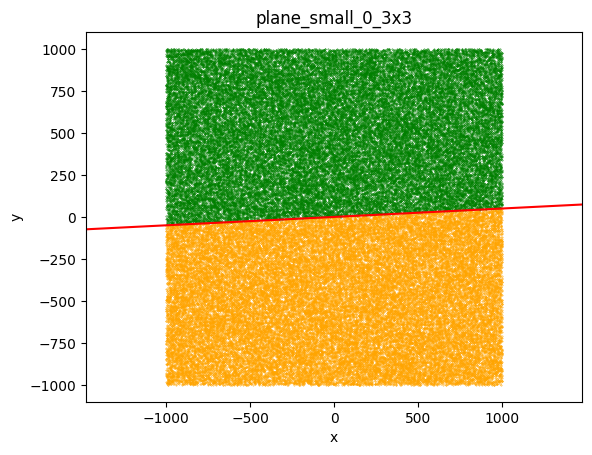

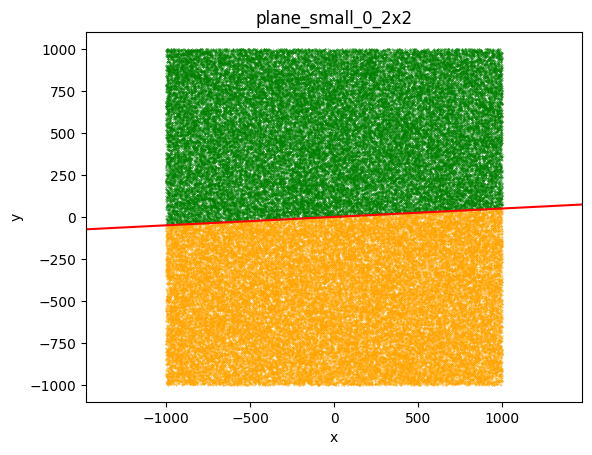

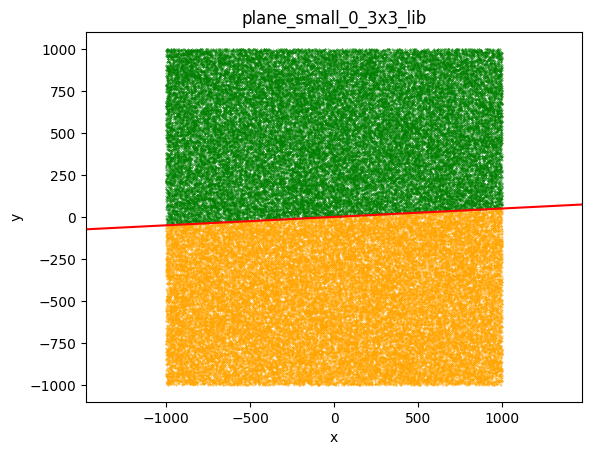

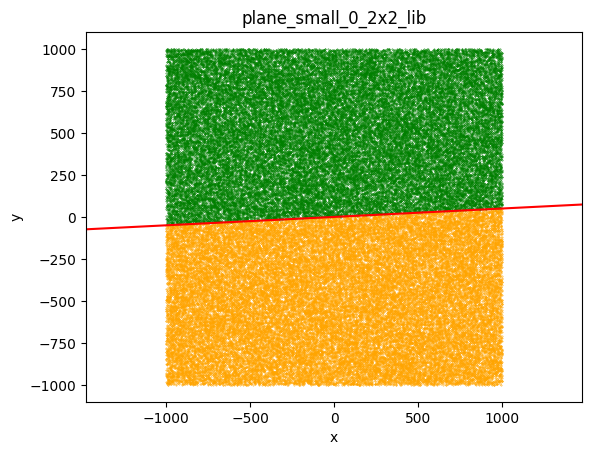

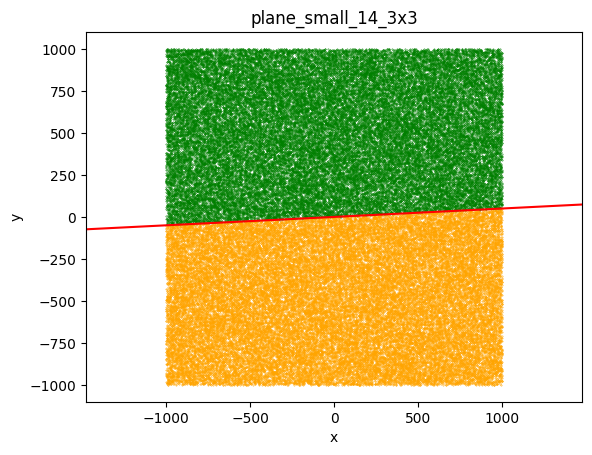

...

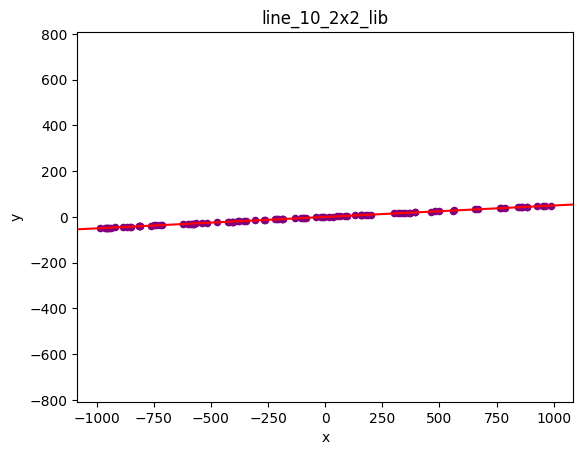

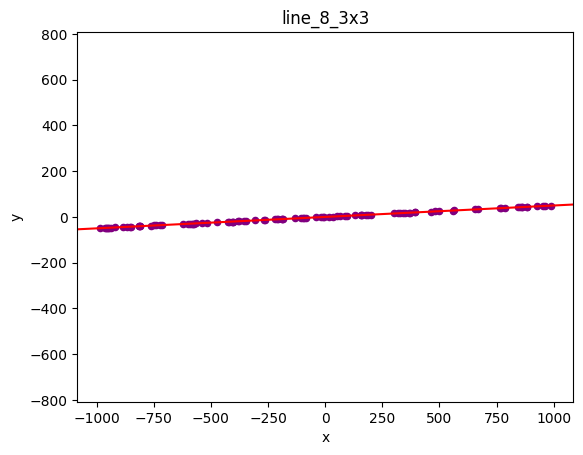

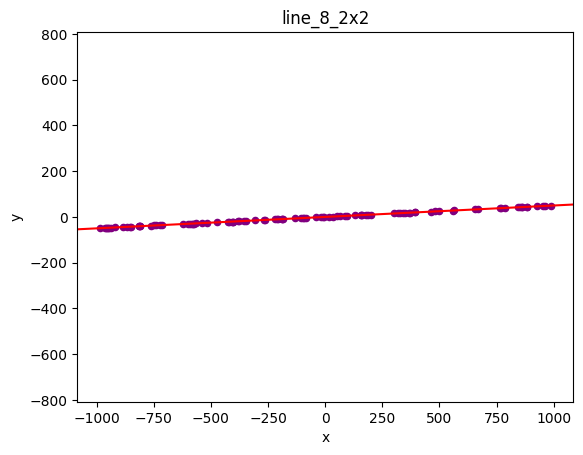

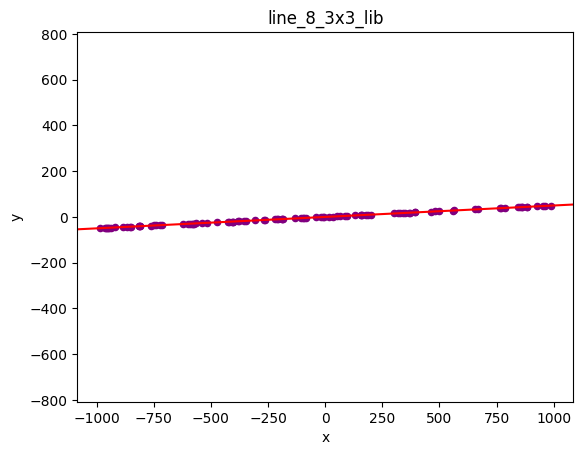

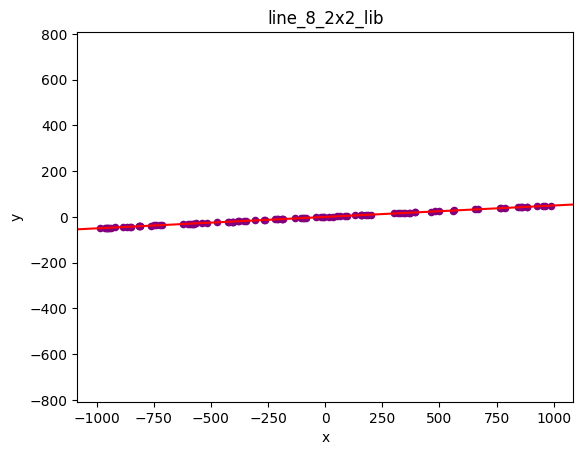

In [27]:
for points_title, points in points_dict.items():
    for eps_title, eps in eps_dict.items():
        for mat_fun_title, mat_fun in mat_fun_dict.items():
            left, mid, right = categorize_points(points, a, b, mat_fun, eps)
            title = '_'.join([points_title, eps_title, mat_fun_title])
            
            #draw_line(left, mid, right, plot_points_size[points_title], title).save(title)

            add_distribution_to_df(points_distribution, len(left), len(mid), len(right), points_title, mat_fun_title, eps_title)

# Wyniki klasyfikacji przedstawione w tabelach poniżej

In [28]:
for df in points_distribution.loc[points_distribution['points'] == 'plane_small'].groupby(['eps']):
    eps_title, data = df
    print(f"Epsilon: 1e-{eps_title[0]}")
    display(data[['mat_fun', 'left', 'mid', 'right']])
    

Epsilon: 1e-0


,mat_fun,left,mid,right
0,3x3,49995,0,50005
1,2x2,49995,0,50005
2,3x3_lib,49995,0,50005
3,2x2_lib,49995,0,50005


Epsilon: 1e-10


,mat_fun,left,mid,right
12,3x3,49995,0,50005
13,2x2,49995,0,50005
14,3x3_lib,49995,0,50005
15,2x2_lib,49995,0,50005


Epsilon: 1e-12


,mat_fun,left,mid,right
8,3x3,49995,0,50005
9,2x2,49995,0,50005
10,3x3_lib,49995,0,50005
11,2x2_lib,49995,0,50005


Epsilon: 1e-14


,mat_fun,left,mid,right
4,3x3,49995,0,50005
5,2x2,49995,0,50005
6,3x3_lib,49995,0,50005
7,2x2_lib,49995,0,50005


Epsilon: 1e-8


,mat_fun,left,mid,right
16,3x3,49995,0,50005
17,2x2,49995,0,50005
18,3x3_lib,49995,0,50005
19,2x2_lib,49995,0,50005


In [29]:
for df in points_distribution.loc[points_distribution['points'] == 'plane_large'].groupby(['eps']):
    eps_title, data = df
    print(f"Epsilon: 1e-{eps_title[0]}")
    display(data[['mat_fun', 'left', 'mid', 'right']])

Epsilon: 1e-0


,mat_fun,left,mid,right
20,3x3,49834,0,50166
21,2x2,49832,6,50162
22,3x3_lib,49834,0,50166
23,2x2_lib,49830,7,50163


Epsilon: 1e-10


,mat_fun,left,mid,right
32,3x3,49834,0,50166
33,2x2,49832,6,50162
34,3x3_lib,49834,0,50166
35,2x2_lib,49830,7,50163


Epsilon: 1e-12


,mat_fun,left,mid,right
28,3x3,49834,0,50166
29,2x2,49832,6,50162
30,3x3_lib,49834,0,50166
31,2x2_lib,49830,7,50163


Epsilon: 1e-14


,mat_fun,left,mid,right
24,3x3,49834,0,50166
25,2x2,49832,6,50162
26,3x3_lib,49834,0,50166
27,2x2_lib,49830,7,50163


Epsilon: 1e-8


,mat_fun,left,mid,right
36,3x3,49834,0,50166
37,2x2,49832,6,50162
38,3x3_lib,49834,0,50166
39,2x2_lib,49830,7,50163


In [30]:
for df in points_distribution.loc[points_distribution['points'] == 'circle'].groupby(['eps']):
    eps_title, data = df
    print(f"Epsilon: 1e-{eps_title[0]}")
    display(data[['mat_fun', 'left', 'mid', 'right']])

Epsilon: 1e-0


,mat_fun,left,mid,right
40,3x3,55,0,45
41,2x2,55,0,45
42,3x3_lib,55,0,45
43,2x2_lib,55,0,45


Epsilon: 1e-10


,mat_fun,left,mid,right
52,3x3,55,0,45
53,2x2,55,0,45
54,3x3_lib,55,0,45
55,2x2_lib,55,0,45


Epsilon: 1e-12


,mat_fun,left,mid,right
48,3x3,55,0,45
49,2x2,55,0,45
50,3x3_lib,55,0,45
51,2x2_lib,55,0,45


Epsilon: 1e-14


,mat_fun,left,mid,right
44,3x3,55,0,45
45,2x2,55,0,45
46,3x3_lib,55,0,45
47,2x2_lib,55,0,45


Epsilon: 1e-8


,mat_fun,left,mid,right
56,3x3,55,0,45
57,2x2,55,0,45
58,3x3_lib,55,0,45
59,2x2_lib,55,0,45


In [31]:
for df in points_distribution.loc[points_distribution['points'] == 'line'].groupby(['eps']):
    eps_title, data = df
    print(f"Epsilon: 1e-{eps_title[0]}")
    display(data[['mat_fun', 'left', 'mid', 'right']])

Epsilon: 1e-0


,mat_fun,left,mid,right
60,3x3,36,25,39
61,2x2,12,71,17
62,3x3_lib,39,24,37
63,2x2_lib,21,63,16


Epsilon: 1e-10


,mat_fun,left,mid,right
72,3x3,0,100,0
73,2x2,0,100,0
74,3x3_lib,0,100,0
75,2x2_lib,0,100,0


Epsilon: 1e-12


,mat_fun,left,mid,right
68,3x3,0,100,0
69,2x2,6,88,6
70,3x3_lib,0,100,0
71,2x2_lib,17,71,12


Epsilon: 1e-14


,mat_fun,left,mid,right
64,3x3,0,100,0
65,2x2,11,73,16
66,3x3_lib,7,83,10
67,2x2_lib,21,64,15


Epsilon: 1e-8


,mat_fun,left,mid,right
76,3x3,0,100,0
77,2x2,0,100,0
78,3x3_lib,0,100,0
79,2x2_lib,0,100,0


Zapis tabeli points_distribution do pliku

In [32]:
points_distribution.to_csv('points_distribution_64bit.csv', index=False)

## Klasyfikacja punktów dla mniejszej precyzji zmiennych
Rozkład punktów dla każdej konfiguracji jest zapisywany w tabeli points_distribution

In [33]:
points_distribution.drop(points_distribution.index, inplace=True)

/home/ktwsz/geometryki/bitalg/visualizer/plot/plot.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
/home/ktwsz/geometryki/bitalg/visualizer/plot/plot.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


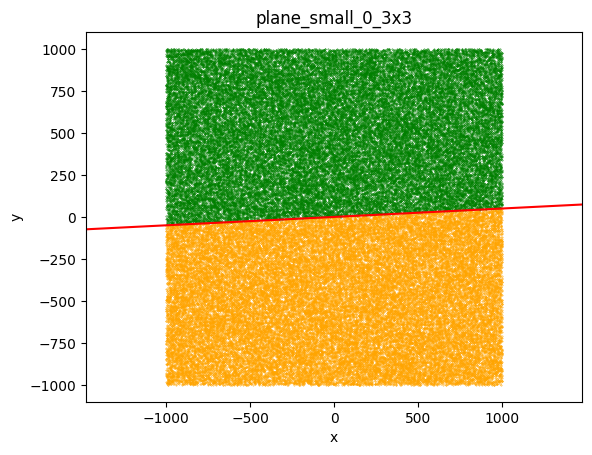

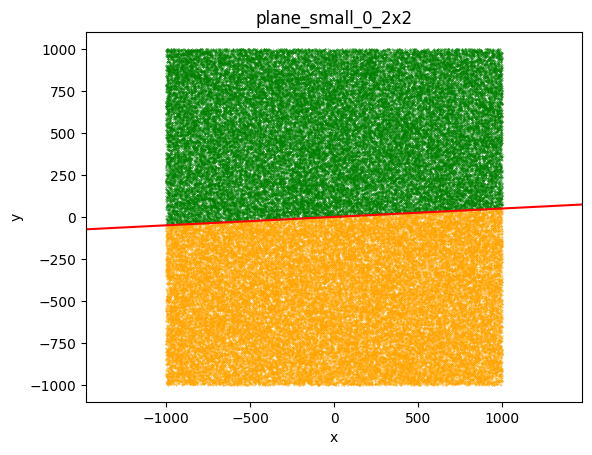

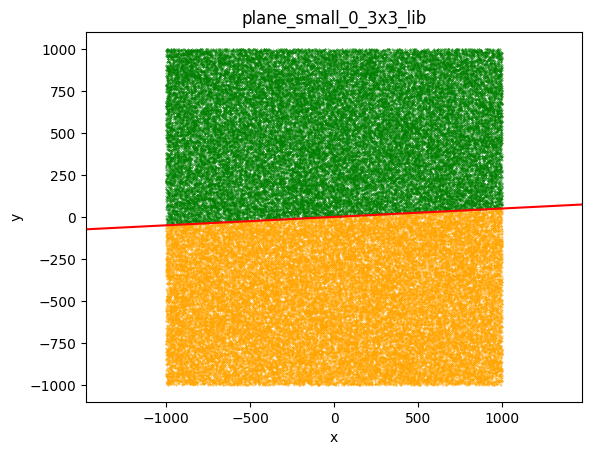

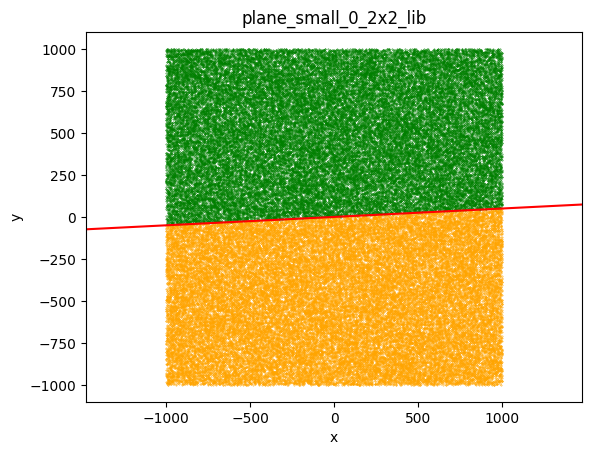

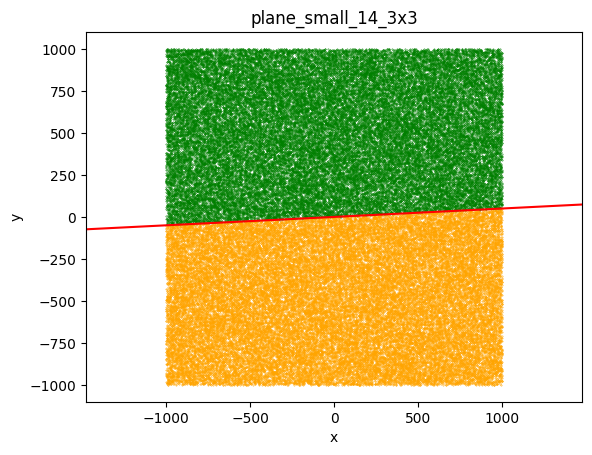

...

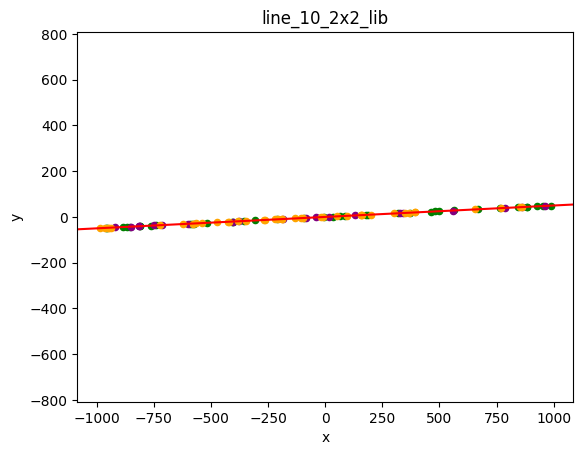

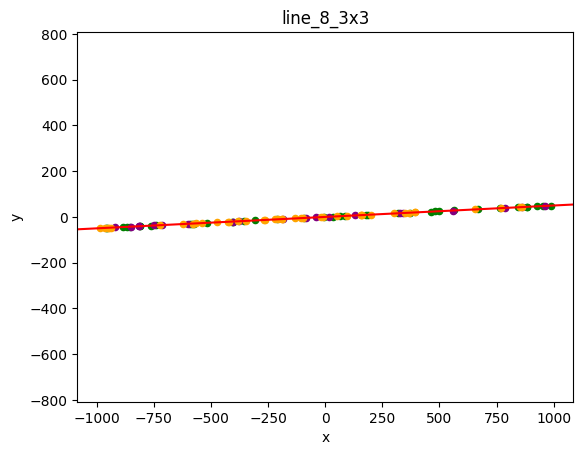

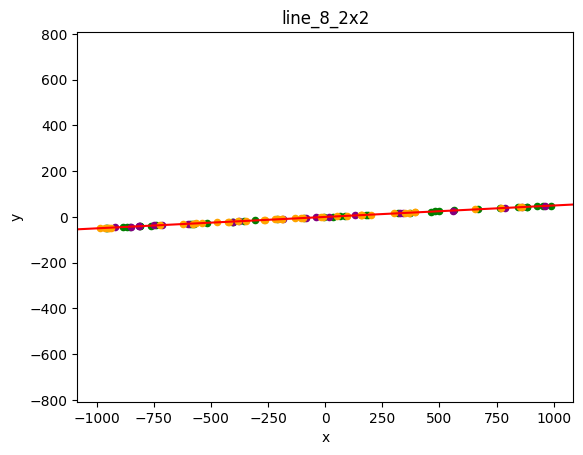

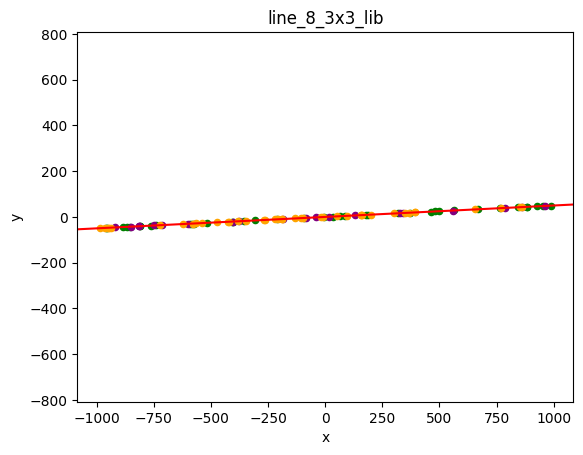

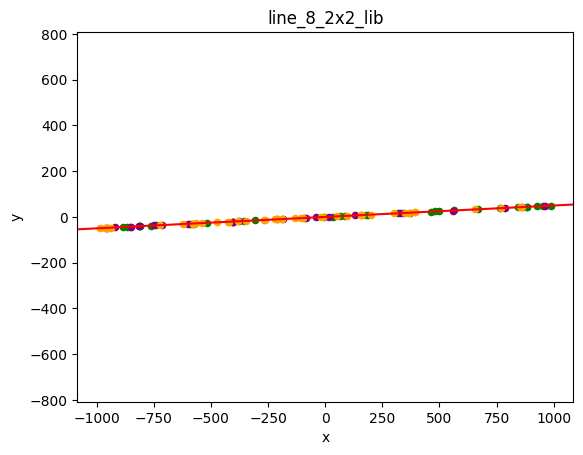

In [34]:
for points_title, points in points_dict.items():
    points = np.float32(points)
    for eps_title, eps in eps_dict.items():
        for mat_fun_title, mat_fun in mat_fun_dict.items():
            left, mid, right = categorize_points(points, a, b, mat_fun, eps)
            title = '_'.join([points_title, eps_title, mat_fun_title])
            
            draw_line(left, mid, right, plot_points_size[points_title], title)#.save(title+"32bit")

            add_distribution_to_df(points_distribution, len(left), len(mid), len(right), points_title, mat_fun_title, eps_title)

# Wyniki

In [35]:
for df in points_distribution.loc[points_distribution['points'] == 'plane_small'].groupby(['eps']):
    eps_title, data = df
    print(f"Epsilon: 1e-{eps_title[0]}")
    display(data[['mat_fun', 'left', 'mid', 'right']])
    

Epsilon: 1e-0


,mat_fun,left,mid,right
0,3x3,49995,0,50005
1,2x2,49995,0,50005
2,3x3_lib,49995,0,50005
3,2x2_lib,49995,0,50005


Epsilon: 1e-10


,mat_fun,left,mid,right
12,3x3,49995,0,50005
13,2x2,49995,0,50005
14,3x3_lib,49995,0,50005
15,2x2_lib,49995,0,50005


Epsilon: 1e-12


,mat_fun,left,mid,right
8,3x3,49995,0,50005
9,2x2,49995,0,50005
10,3x3_lib,49995,0,50005
11,2x2_lib,49995,0,50005


Epsilon: 1e-14


,mat_fun,left,mid,right
4,3x3,49995,0,50005
5,2x2,49995,0,50005
6,3x3_lib,49995,0,50005
7,2x2_lib,49995,0,50005


Epsilon: 1e-8


,mat_fun,left,mid,right
16,3x3,49995,0,50005
17,2x2,49995,0,50005
18,3x3_lib,49995,0,50005
19,2x2_lib,49995,0,50005


In [36]:
for df in points_distribution.loc[points_distribution['points'] == 'plane_large'].groupby(['eps']):
    eps_title, data = df
    print(f"Epsilon: 1e-{eps_title[0]}")
    display(data[['mat_fun', 'left', 'mid', 'right']])

Epsilon: 1e-0


,mat_fun,left,mid,right
20,3x3,49834,0,50166
21,2x2,49832,6,50162
22,3x3_lib,49834,0,50166
23,2x2_lib,49830,7,50163


Epsilon: 1e-10


,mat_fun,left,mid,right
32,3x3,49834,0,50166
33,2x2,49832,6,50162
34,3x3_lib,49834,0,50166
35,2x2_lib,49830,7,50163


Epsilon: 1e-12


,mat_fun,left,mid,right
28,3x3,49834,0,50166
29,2x2,49832,6,50162
30,3x3_lib,49834,0,50166
31,2x2_lib,49830,7,50163


Epsilon: 1e-14


,mat_fun,left,mid,right
24,3x3,49834,0,50166
25,2x2,49832,6,50162
26,3x3_lib,49834,0,50166
27,2x2_lib,49830,7,50163


Epsilon: 1e-8


,mat_fun,left,mid,right
36,3x3,49834,0,50166
37,2x2,49832,6,50162
38,3x3_lib,49834,0,50166
39,2x2_lib,49830,7,50163


In [37]:
for df in points_distribution.loc[points_distribution['points'] == 'circle'].groupby(['eps']):
    eps_title, data = df
    print(f"Epsilon: 1e-{eps_title[0]}")
    display(data[['mat_fun', 'left', 'mid', 'right']])

Epsilon: 1e-0


,mat_fun,left,mid,right
40,3x3,55,0,45
41,2x2,55,0,45
42,3x3_lib,55,0,45
43,2x2_lib,55,0,45


Epsilon: 1e-10


,mat_fun,left,mid,right
52,3x3,55,0,45
53,2x2,55,0,45
54,3x3_lib,55,0,45
55,2x2_lib,55,0,45


Epsilon: 1e-12


,mat_fun,left,mid,right
48,3x3,55,0,45
49,2x2,55,0,45
50,3x3_lib,55,0,45
51,2x2_lib,55,0,45


Epsilon: 1e-14


,mat_fun,left,mid,right
44,3x3,55,0,45
45,2x2,55,0,45
46,3x3_lib,55,0,45
47,2x2_lib,55,0,45


Epsilon: 1e-8


,mat_fun,left,mid,right
56,3x3,55,0,45
57,2x2,55,0,45
58,3x3_lib,55,0,45
59,2x2_lib,55,0,45


In [38]:
for df in points_distribution.loc[points_distribution['points'] == 'line'].groupby(['eps']):
    eps_title, data = df
    print(f"Epsilon: 1e-{eps_title[0]}")
    display(data[['mat_fun', 'left', 'mid', 'right']])

Epsilon: 1e-0


,mat_fun,left,mid,right
60,3x3,47,7,46
61,2x2,41,15,44
62,3x3_lib,47,8,45
63,2x2_lib,41,14,45


Epsilon: 1e-10


,mat_fun,left,mid,right
72,3x3,39,20,41
73,2x2,39,20,41
74,3x3_lib,39,20,41
75,2x2_lib,39,20,41


Epsilon: 1e-12


,mat_fun,left,mid,right
68,3x3,39,20,41
69,2x2,39,20,41
70,3x3_lib,39,20,41
71,2x2_lib,41,15,44


Epsilon: 1e-14


,mat_fun,left,mid,right
64,3x3,39,20,41
65,2x2,41,15,44
66,3x3_lib,40,18,42
67,2x2_lib,41,14,45


Epsilon: 1e-8


,mat_fun,left,mid,right
76,3x3,39,20,41
77,2x2,39,20,41
78,3x3_lib,39,20,41
79,2x2_lib,39,20,41


Zapis tabeli points_distribution do pliku

In [39]:
points_distribution.to_csv('points_distribution_32bit.csv')

## Opisz swoje wnioski na podstawie przeprowadzonych własnoręcznie testów.


Dla punktów na płaszczyźnie oraz na okręgu wyniki są takie same bez względu na epsilon, sposób lcizenia wyznacznika czy precyzję zmiennych zmiennoprzecinkowych. Różnice pojawiają się dopiero przy klasyfikacji punktów na prostej. 

Przy zmiennych o większej precyzji wszystkie punkty zostały zaklasyfikowane na prostej dla epsilonów większych bądź równych 1e-10 dla każdego wyznacznika. Gdy precyzja była mniejsza, własna implementacja wyznaczników radziła sobie lepiej od funkcji zaimportowanej z numpy. Dla epislon 1e-12 i 1e-14 wyznacznik 3x3 zaklasyfikował wszystkie punkty na prostej, natomiast dla epsilon równego 0 punkty był równomiernie rozłożone na wszystkie trzy strony. Wyznacznik 2x2 dla wszystkich trzech epsilonów zaklasyfikował większość punktów (70-80 ze 100) na prostej.

Przy zmniejszeniu precyzji zmiennych, klasyfikacja wciąż jest poprawna dla pierwszych trzech zbiorów punktów. W przypadku prostej, żaden z wyznaczników nie radzi sobie, nawet dla największego epsilon 1e-8. Na prostej zostało sklasyfikowane co najwyżej 20 punktów ze 100.

### Wnioski
Zmienne o precyzji 64 bitowej radzą sobie zdecydowanie lepiej z zadaniem. Różnice między wyznacznikami własnymi a importowanymi z biblioteki nie są drastyczne, jednak widoczne przy klasyfikowaniu punktów na prostej. Najlepiej radzi sobie wyznacznik 3x3, przy precyzji 1e-14.